In [1]:
import pandas as pd 

In [ ]:
df=pd.read_csv('D:\College Project\job_trend_predictor\data_collection\jobs.csv')
df.head(2)

<>:1: SyntaxWarning: invalid escape sequence '\C'
<>:1: SyntaxWarning: invalid escape sequence '\C'
C:\Users\harsh\AppData\Local\Temp\ipykernel_26944\771331899.py:1: SyntaxWarning: invalid escape sequence '\C'
  df=pd.read_csv('D:\College Project\job_trend_predictor\data_collection\jobs.csv')


,Unnamed: 0,Job Id,Experience,Qualifications,Salary Range,location,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,Preference,Contact Person,Contact,Job Title,Role,Job Portal,Job Description,Benefits,skills,Responsibilities,Company,Company Profile
0,61,401560922349533,5 to 12 Years,PhD,$57K-$125K,New Delhi,India,20.5937,78.9629,Full-Time,42159,2022-09-28,Female,Samantha Ramirez,635.430.4890,Account Executive,Sales Account Executive,Internships.com,"A Sales Account Executive is responsible for acquiring and managing business accounts. They identify sales opportunities, negotiate contracts, and meet revenue targets.","{'Flexible Spending Accounts (FSAs), Relocation Assistance, Legal Assistance, Employee Recognition Programs, Financial Counseling'}",Sales strategies and tactics Account management Relationship building Sales forecasting Industry and product knowledge,Identify and pursue sales opportunities with new and existing clients. Build and maintain client relationships. Meet or exceed sales targets and quotas.,GlaxoSmithKline,"{""Sector"":""Pharmaceuticals"",""Industry"":""Pharmaceuticals"",""City"":""London"",""State"":""N/A"",""Zip"":""N/A"",""Website"":""www.gsk.com"",""Ticker"":""GSK"",""CEO"":""Emma Walmsley""}"
1,145,2122997813566133,0 to 14 Years,BBA,$55K-$95K,New Delhi,India,20.5937,78.9629,Contract,102180,2022-07-17,Female,Michael Harris,001-231-466-9867x086,Customer Service Representative,Call Center Agent,Jobs2Careers,"A Call Center Agent handles incoming and outgoing customer calls, providing assistance, resolving issues, and ensuring a positive customer experience over the phone.","{'Childcare Assistance, Paid Time Off (PTO), Relocation Assistance, Flexible Work Arrangements, Professional Development'}",Customer service Call center operations Problem-solving skills,Handle incoming phone calls and provide information or assistance. Follow call scripts and procedures. Document and report call details.,Textron,"{""Sector"":""Aerospace & Defense"",""Industry"":""Aerospace & Defense"",""City"":""Providence"",""State"":""Rhose Island"",""Zip"":""2903"",""Website"":""www.textron.com"",""Ticker"":""TXT"",""CEO"":""Scott C. Donnelly""}"


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7449 entries, 0 to 7448
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Unnamed: 0        7449 non-null   int64  
 1   Job Id            7449 non-null   int64  
 2   Experience        7449 non-null   object 
 3   Qualifications    7449 non-null   object 
 4   Salary Range      7449 non-null   object 
 5   location          7449 non-null   object 
 6   Country           7449 non-null   object 
 7   latitude          7449 non-null   float64
 8   longitude         7449 non-null   float64
 9   Work Type         7449 non-null   object 
 10  Company Size      7449 non-null   int64  
 11  Job Posting Date  7449 non-null   object 
 12  Preference        7449 non-null   object 
 13  Contact Person    7449 non-null   object 
 14  Contact           7449 non-null   object 
 15  Job Title         7449 non-null   object 
 16  Role              7449 non-null   object 


In [ ]:
# Check missing values
print("Missing values:\n", df.isnull().sum())

Missing values:
 Unnamed: 0           0
Job Id               0
Experience           0
Qualifications       0
Salary Range         0
location             0
Country              0
latitude             0
longitude            0
Work Type            0
Company Size         0
Job Posting Date     0
Preference           0
Contact Person       0
Contact              0
Job Title            0
Role                 0
Job Portal           0
Job Description      0
Benefits             0
skills               0
Responsibilities     0
Company              0
Company Profile     23
dtype: int64


In [ ]:
df.dropna(inplace=True)

In [ ]:
df.dtypes

Unnamed: 0            int64
Job Id                int64
Experience           object
Qualifications       object
Salary Range         object
location             object
Country              object
latitude            float64
longitude           float64
Work Type            object
Company Size          int64
Job Posting Date     object
Preference           object
Contact Person       object
Contact              object
Job Title            object
Role                 object
Job Portal           object
Job Description      object
Benefits             object
skills               object
Responsibilities     object
Company              object
Company Profile      object
dtype: object

In [ ]:
# Drop unnecessary columns (like the index column)
df = df.drop('Unnamed: 0', axis=1, errors='ignore')

In [ ]:


# Clean salary range (extract min and max salary)
def extract_salary(salary_range):
    salary_range = str(salary_range)
    nums = [int(''.join(filter(str.isdigit, x))) for x in salary_range.split('-')]
    return pd.Series({'min_salary': (nums[0]*83*1000)/2, 'max_salary': (nums[1]*83*1000)/2})

df[['min_salary', 'max_salary']] = df['Salary Range'].apply(extract_salary)

# Convert experience range to numeric
def extract_experience(exp_range):
    exp_range = str(exp_range)
    nums = [int(''.join(filter(str.isdigit, x))) for x in exp_range.split('to')]
    return pd.Series({'min_experience': nums[0], 'max_experience': nums[1]})

df[['min_experience', 'max_experience']] = df['Experience'].apply(extract_experience)

In [ ]:
df

,Job Id,Experience,Qualifications,Salary Range,location,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,Preference,Contact Person,Contact,Job Title,Role,Job Portal,Job Description,Benefits,skills,Responsibilities,Company,Company Profile,min_salary,max_salary,min_experience,max_experience
0,401560922349533,5 to 12 Years,PhD,$57K-$125K,New Delhi,India,20.5937,78.9629,Full-Time,42159,2022-09-28,Female,Samantha Ramirez,635.430.4890,Account Executive,Sales Account Executive,Internships.com,"A Sales Account Executive is responsible for acquiring and managing business accounts. They identify sales opportunities, negotiate contracts, and meet revenue targets.","{'Flexible Spending Accounts (FSAs), Relocation Assistance, Legal Assistance, Employee Recognition Programs, Financial Counseling'}",Sales strategies and tactics Account management Relationship building Sales forecasting Industry and product knowledge,Identify and pursue sales opportunities with new and existing clients. Build and maintain client relationships. Meet or exceed sales targets and quotas.,GlaxoSmithKline,"{""Sector"":""Pharmaceuticals"",""Industry"":""Pharmaceuticals"",""City"":""London"",""State"":""N/A"",""Zip"":""N/A"",""Website"":""www.gsk.com"",""Ticker"":""GSK"",""CEO"":""Emma Walmsley""}",2365500.0,5187500.0,5,12
1,2122997813566133,0 to 14 Years,BBA,$55K-$95K,New Delhi,India,20.5937,78.9629,Contract,102180,2022-07-17,Female,Michael Harris,001-231-466-9867x086,Customer Service Representative,Call Center Agent,Jobs2Careers,"A Call Center Agent handles incoming and outgoing customer calls, providing assistance, resolving issues, and ensuring a positive customer experience over the phone.","{'Childcare Assistance, Paid Time Off (PTO), Relocation Assistance, Flexible Work Arrangements, Professional Development'}",Customer service Call center operations Problem-solving skills,Handle incoming phone calls and provide information or assistance. Follow call scripts and procedures. Document and report call details.,Textron,"{""Sector"":""Aerospace & Defense"",""Industry"":""Aerospace & Defense"",""City"":""Providence"",""State"":""Rhose Island"",""Zip"":""2903"",""Website"":""www.textron.com"",""Ticker"":""TXT"",""CEO"":""Scott C. Donnelly""}",2282500.0,3942500.0,0,14
2,3096609007532611,4 to 13 Years,BBA,$55K-$108K,New Delhi,India,20.5937,78.9629,Full-Time,39814,2022-01-27,Male,Veronica Morgan,(764)507-7284,Civil Engineer,Water Resources Engineer,Internships.com,"A Water Resources Engineer manages and develops water-related projects, such as dams, irrigation systems, and flood control measures, to ensure water resource sustainability.","{'Flexible Spending Accounts (FSAs), Relocation Assistance, Legal Assistance, Employee Recognition Programs, Financial Counseling'}",Water resources engineering Hydrology and hydraulics Environmental impact assessment Water resource modeling software Watershed management,"Focus on water-related projects, such as flood control, water supply, and wastewater treatment. Design and manage water resource systems and infrastructure. Address water quality and conservation ...",Nucor,"{""Sector"":""Metals and Mining"",""Industry"":""Metals"",""City"":""Charlotte"",""State"":""North Carolina"",""Zip"":""28211"",""Website"":""www.nucor.com"",""Ticker"":""NUE"",""CEO"":""Leon J. Topalian""}",2282500.0,4482000.0,4,13
3,387786646229837,1 to 8 Years,BA,$64K-$92K,New Delhi,India,20.5937,78.9629,Contract,48770,2021-09-26,Female,Nicholas Fisher,(568)816-5906x200,Veterinarian,Equine Veterinarian,USAJOBS,"An Equine Veterinarian specializes in the health and well-being of horses. They diagnose and treat equine illnesses, perform surgeries, and provide preventive care for horses.","{'Legal Assistance, Bonuses and Incentive Programs, Wellness Programs, Employee Discounts, Retirement Plans'}",Equine veterinary medicine Horse anatomy and physiology Lameness evaluation Equine surgery Dentistry for horses Emergency equine care Equine reproducti

In [ ]:
df['min_salary'].describe()

count    7.426000e+03
mean     2.489346e+06
std      1.312762e+05
min      2.282500e+06
25%      2.365500e+06
50%      2.490000e+06
75%      2.614500e+06
max      2.697500e+06
Name: min_salary, dtype: float64

In [ ]:
# Clean text columns
text_columns = ['Job Title', 'Role', 'Job Description', 'Company']
for col in text_columns:
    # Convert to lowercase
    df[col] = df[col].str.lower()
    # Remove special characters
    df[col] = df[col].str.replace('[^\w\s]', '', regex=True)
    # Remove extra whitespace
    df[col] = df[col].str.strip()

<>:7: SyntaxWarning: invalid escape sequence '\w'
<>:7: SyntaxWarning: invalid escape sequence '\w'
C:\Users\harsh\AppData\Local\Temp\ipykernel_26944\991771370.py:7: SyntaxWarning: invalid escape sequence '\w'
  df[col] = df[col].str.replace('[^\w\s]', '', regex=True)


In [ ]:
# Convert categorical variables to numeric using label encoding
from sklearn.preprocessing import LabelEncoder

categorical_cols = ['Work Type', 'Preference', 'Qualifications']
le = LabelEncoder()

for col in categorical_cols:
    df[f'{col}_encoded'] = le.fit_transform(df[col])

In [ ]:
df1=df.copy()

In [ ]:
df.head()

,Job Id,Experience,Qualifications,Salary Range,location,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,Preference,Contact Person,Contact,Job Title,Role,Job Portal,Job Description,Benefits,skills,Responsibilities,Company,Company Profile,min_salary,max_salary,min_experience,max_experience,Work Type_encoded,Preference_encoded,Qualifications_encoded
0,401560922349533,5 to 12 Years,PhD,$57K-$125K,New Delhi,India,20.5937,78.9629,Full-Time,42159,2022-09-28,Female,Samantha Ramirez,635.430.4890,account executive,sales account executive,Internships.com,a sales account executive is responsible for acquiring and managing business accounts they identify sales opportunities negotiate contracts and meet revenue targets,"{'Flexible Spending Accounts (FSAs), Relocation Assistance, Legal Assistance, Employee Recognition Programs, Financial Counseling'}",Sales strategies and tactics Account management Relationship building Sales forecasting Industry and product knowledge,Identify and pursue sales opportunities with new and existing clients. Build and maintain client relationships. Meet or exceed sales targets and quotas.,glaxosmithkline,"{""Sector"":""Pharmaceuticals"",""Industry"":""Pharmaceuticals"",""City"":""London"",""State"":""N/A"",""Zip"":""N/A"",""Website"":""www.gsk.com"",""Ticker"":""GSK"",""CEO"":""Emma Walmsley""}",2365500.0,5187500.0,5,12,1,1,9
1,2122997813566133,0 to 14 Years,BBA,$55K-$95K,New Delhi,India,20.5937,78.9629,Contract,102180,2022-07-17,Female,Michael Harris,001-231-466-9867x086,customer service representative,call center agent,Jobs2Careers,a call center agent handles incoming and outgoing customer calls providing assistance resolving issues and ensuring a positive customer experience over the phone,"{'Childcare Assistance, Paid Time Off (PTO), Relocation Assistance, Flexible Work Arrangements, Professional Development'}",Customer service Call center operations Problem-solving skills,Handle incoming phone calls and provide information or assistance. Follow call scripts and procedures. Document and report call details.,textron,"{""Sector"":""Aerospace & Defense"",""Industry"":""Aerospace & Defense"",""City"":""Providence"",""State"":""Rhose Island"",""Zip"":""2903"",""Website"":""www.textron.com"",""Ticker"":""TXT"",""CEO"":""Scott C. Donnelly""}",2282500.0,3942500.0,0,14,0,1,3
2,3096609007532611,4 to 13 Years,BBA,$55K-$108K,New Delhi,India,20.5937,78.9629,Full-Time,39814,2022-01-27,Male,Veronica Morgan,(764)507-7284,civil engineer,water resources engineer,Internships.com,a water resources engineer manages and develops waterrelated projects such as dams irrigation systems and flood control measures to ensure water resource sustainability,"{'Flexible Spending Accounts (FSAs), Relocation Assistance, Legal Assistance, Employee Recognition Programs, Financial Counseling'}",Water resources engineering Hydrology and hydraulics Environmental impact assessment Water resource modeling software Watershed management,"Focus on water-related projects, such as flood control, water supply, and wastewater treatment. Design and manage water resource systems and infrastructure. Address water quality and conservation ...",nucor,"{""Sector"":""Metals and Mining"",""Industry"":""Metals"",""City"":""Charlotte"",""State"":""North Carolina"",""Zip"":""28211"",""Website"":""www.nucor.com"",""Ticker"":""NUE"",""CEO"":""Leon J. Topalian""}",2282500.0,4482000.0,4,13,1,2,3
3,387786646229837,1 to 8 Years,BA,$64K-$92K,New Delhi,India,20.5937,78.9629,Contract,48770,2021-09-26,Female,Nicholas Fisher,(568)816-5906x200,veterinarian,equine veterinarian,USAJOBS,an equine veterinarian specializes in the health and wellbeing of horses they diagnose and treat equine illnesses perform surgeries and provide preventive care for horses,"{'Legal Assistance, Bonuses and Incentive Programs, Wellness Programs, Employee Discounts, Retirement Plans'}",Equine veterinary medicine Horse anatomy and physiology Lameness evaluation Equine surgery Dentistry

In [ ]:
# Calculate average salary
df['avg_salary'] = (df['min_salary'] + df['max_salary']) / 2

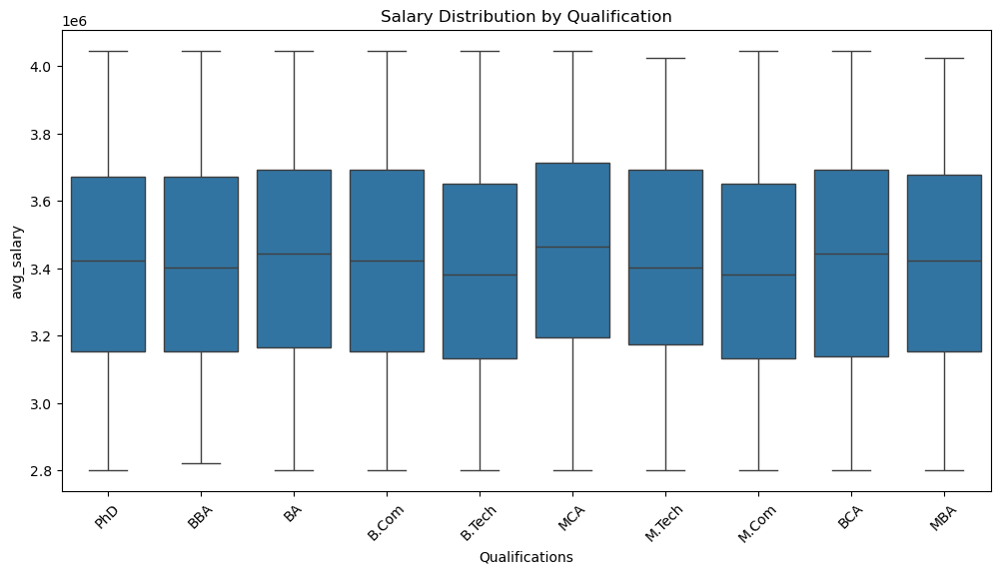

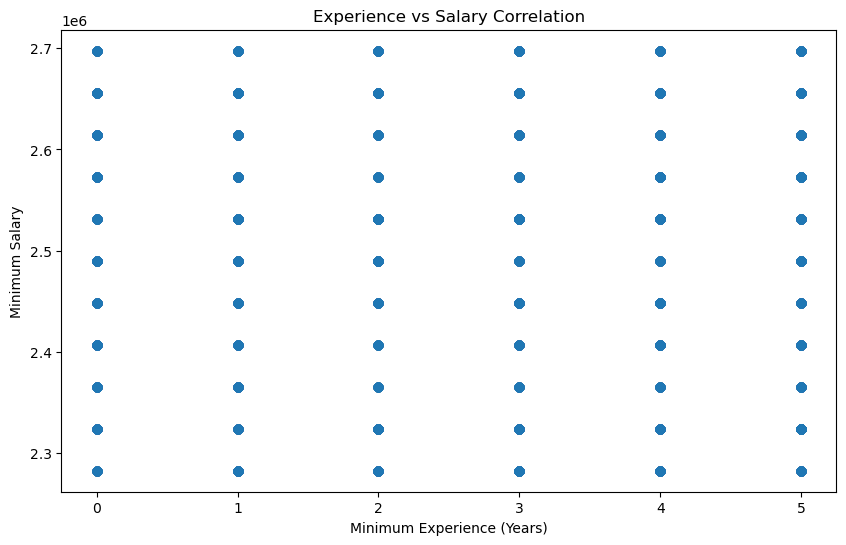

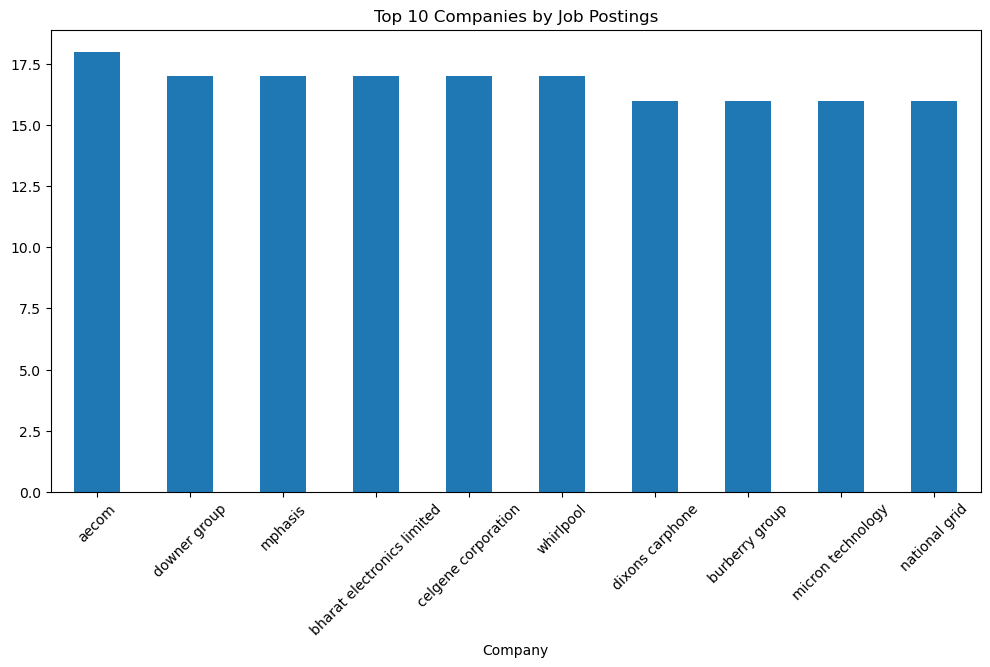

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Salary distribution by qualification
plt.figure(figsize=(12, 6))
sns.boxplot(x='Qualifications', y='avg_salary', data=df)
plt.xticks(rotation=45)
plt.title('Salary Distribution by Qualification')
plt.show()

# Experience vs Salary correlation
plt.figure(figsize=(10, 6))
plt.scatter(df['min_experience'], df['min_salary'])
plt.xlabel('Minimum Experience (Years)')
plt.ylabel('Minimum Salary')
plt.title('Experience vs Salary Correlation')
plt.show()

# Top companies by job postings
plt.figure(figsize=(12, 6))
df['Company'].value_counts().head(10).plot(kind='bar')
plt.title('Top 10 Companies by Job Postings')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import re
import pandas as pd

# -------------------------
# Common fixes for broken tokens
# -------------------------
FIX_PATTERNS = [
    (r'\bH\s*,\s*T\s*,\s*M\s*,\s*L\b', 'HTML'),
    (r'\bC\s*,\s*S\s*,\s*S\b', 'CSS'),
    (r'\bJava\s*,?\s*Script\b', 'JavaScript'),
    (r'\bNode\s*,?\s*\.?\s*js\b', 'Node.js'),
    (r'\bReact\s*,?\s*\.?\s*js\b', 'React.js'),
]

JOIN_MAP = {
    ('Java', 'Script'): 'JavaScript',
    ('Node', '.js'): 'Node.js',
    ('React', '.js'): 'React.js',
}

# -------------------------
# Function to split skills
# -------------------------
def split_skills_by_capitals(raw):
    if raw is None:
        return []
    s = str(raw).strip()

    # Remove outer brackets [ ] if present
    s = re.sub(r'^\[+|\]+$', '', s).strip()

    # Remove content inside any type of brackets (round, square, curly)
    s = re.sub(r'\([^)]*\)', '', s)
    s = re.sub(r'\[[^\]]*\]', '', s)
    s = re.sub(r'\{[^}]*\}', '', s)

    # Apply known fixes for broken tokens
    for pat, repl in FIX_PATTERNS:
        s = re.sub(pat, repl, s, flags=re.IGNORECASE)

    # Normalize separators
    s = re.sub(r'[,\;/\|]+', ' ', s)

    # Remove ' and ' / ' or ' (case-insensitive)
    s = re.sub(r'\b(and|or)\b', ' ', s, flags=re.IGNORECASE)

    # Collapse extra spaces
    s = re.sub(r'\s+', ' ', s).strip()

    if not s:
        return []

    # Detect capital-start tokens
    starts = []
    for i, ch in enumerate(s):
        if ch.isupper() and (i == 0 or s[i-1].isspace()):
            starts.append(i)

    if not starts:
        return [s]

    spans = []
    for idx, st in enumerate(starts):
        end = starts[idx+1] if idx+1 < len(starts) else len(s)
        skill = s[st:end].strip().strip(' .;:,')
        if skill:
            spans.append(skill)

    # Merge known token pairs
    final = []
    i = 0
    while i < len(spans):
        tok = spans[i]
        if i + 1 < len(spans):
            pair = (re.sub(r'\W+', '', tok).title(), re.sub(r'\W+', '', spans[i+1]).title())
            if pair in JOIN_MAP:
                final.append(JOIN_MAP[pair])
                i += 2
                continue
        final.append(tok)
        i += 1

    # Deduplicate while preserving order
    seen = set()
    unique = []
    for item in final:
        key = item.lower()
        if key not in seen:
            seen.add(key)
            unique.append(item)

    return unique


# -------------------------
# Example usage
# -------------------------
if __name__ == "__main__":
    df = pd.read_csv("D:\College Project\job_trend_predictor\data_collection\jobs.csv")
    df['sepp_skills'] = df['skills'].apply(split_skills_by_capitals)


<>:99: SyntaxWarning: invalid escape sequence '\C'
<>:99: SyntaxWarning: invalid escape sequence '\C'
C:\Users\harsh\AppData\Local\Temp\ipykernel_26944\2851838199.py:99: SyntaxWarning: invalid escape sequence '\C'
  df = pd.read_csv("D:\College Project\job_trend_predictor\data_collection\jobs.csv")


In [ ]:
df.columns

Index(['Unnamed: 0', 'Job Id', 'Experience', 'Qualifications', 'Salary Range',
       'location', 'Country', 'latitude', 'longitude', 'Work Type',
       'Company Size', 'Job Posting Date', 'Preference', 'Contact Person',
       'Contact', 'Job Title', 'Role', 'Job Portal', 'Job Description',
       'Benefits', 'skills', 'Responsibilities', 'Company', 'Company Profile',
       'sepp_skills'],
      dtype='object')

In [ ]:
df.drop(columns=['Unnamed: 0',], inplace=True)